In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from MAS_library import MASL
import base_for_images as bfi

In [2]:
params = {'legend.fontsize': 7,
          'legend.handlelength': 2}
mpl.rcParams['figure.dpi'] = 550
mpl.rcParams['font.family'] = 'serif'
plt.rcParams.update(params)

In [4]:
cmaps = list(mpl.cm.cmap_d.keys())
cmpsel = ['afmhot', 'cubehelix']

/cvmfs/soft.computecanada.ca/easybuild/software/2020/avx2/Core/python/3.8.10/lib/python3.8/_collections_abc.py:702: MatplotlibDeprecationWarning: The global colormaps dictionary is no longer considered public API.
  return len(self._mapping)
/cvmfs/soft.computecanada.ca/easybuild/software/2020/avx2/Core/python/3.8.10/lib/python3.8/_collections_abc.py:720: MatplotlibDeprecationWarning: The global colormaps dictionary is no longer considered public API.
  yield from self._mapping


In [15]:
grid=2048
BoxSize=500
basefolder = '/home/ayuba/scratch/'
sim = 'm25s7'
cmp = 'cubehelix'
zmin, zmax = 100, 105
vmax=3.3
mlim = 1e13
for s in range(17, 118):
#s = 110
    plt.figure()
    z, pos = bfi.read_pos(basefolder, sim, s)
    hal_x, hal_y, hal_z = bfi.read_hal_pos(basefolder, sim , s, mlim)


    inds = np.where((pos[:,2]>=zmin) & (pos[:,2]<=zmax))[0]

    npos = pos[inds]
    npos[:,2]-= zmin
    nhal_x = hal_x[(hal_z>zmin)*(hal_z<zmax)]
    nhal_y = hal_y[(hal_z>zmin)*(hal_z<zmax)]

    density_field = np.zeros((grid,grid), dtype=np.float32)
    MASL.MA(npos[:,0:2].astype(np.float32), density_field, BoxSize, MAS='CIC')
    density_field /= np.mean(density_field)

    plt.imshow(np.log10(1+density_field.T), interpolation='sinc', cmap=cmp, vmin=0.05, vmax=vmax, origin='lower')
    plt.scatter((nhal_x/BoxSize)*grid, (nhal_y/BoxSize)*grid, s=0.08, c='r')
    plt.text(880, 180, 'z={:1.2f}'.format(z), color='white') 

    ax = plt.gca()
    ax.set_xticks([])
    ax.set_yticks([])
    
    plt.savefig('./snapfigs/{}_bins{}_cmap{}_snap{}_vmax{}_wgroups{:1.2e}.png'.format(sim, grid, cmp, s, vmax, mlim), bbox_inches='tight', dpi=1000, facecolor='white', transparent=False)


## Test with one 

In [5]:
from astropy.cosmology import LambdaCDM
s= 0
BoxSize=500
mlim = 1e14

sim = 'm25s7'
cmp = 'cubehelix'
zmin, zmax = 100, 105
om0 = 0.25
s8 = 0.7 
h=0.7
cosmol = LambdaCDM(H0=100 * h, Om0=om0, Ode0=1 - om0)

z, pos = bfi.read_pos(basefolder, sim, s)
age = cosmol.age(z).value
inds = np.where((pos[:,2]>=zmin) & (pos[:,2]<=zmax))[0]

npos = pos[inds]
npos[:,2]-= zmin
ngroups=0
if s>17:
    hal_x, hal_y, hal_z = bfi.read_hal_pos(basefolder, sim , s, mlim)
    nhal_x = hal_x[(hal_z>zmin)*(hal_z<zmax)]
    nhal_y = hal_y[(hal_z>zmin)*(hal_z<zmax)]
    ngroups = len(nhal_x)

## One snap, no groups

In [19]:
from astropy.cosmology import LambdaCDM
s= 118
BoxSize=500

sim = 'm25s7'
cmp = 'cubehelix'
zmin, zmax = 100, 105
om0 = 0.25
s8 = 0.7 
h=0.7
cosmol = LambdaCDM(H0=100 * h, Om0=om0, Ode0=1 - om0)

z, pos = bfi.read_pos(basefolder, sim, s)
age = cosmol.age(z).value
inds = np.where((pos[:,2]>=zmin) & (pos[:,2]<=zmax))[0]

npos = pos[inds]
npos[:,2]-= zmin
ngroups=0

In [20]:
grid=2048

density_field = np.zeros((grid,grid), dtype=np.float32)
MASL.MA(npos[:,0:2].astype(np.float32), density_field, BoxSize, MAS='CIC')
density_field /= np.mean(density_field)
zr = np.log10(1+density_field)
print(np.max(zr))

3.215724


In [21]:
vmax = 3.2

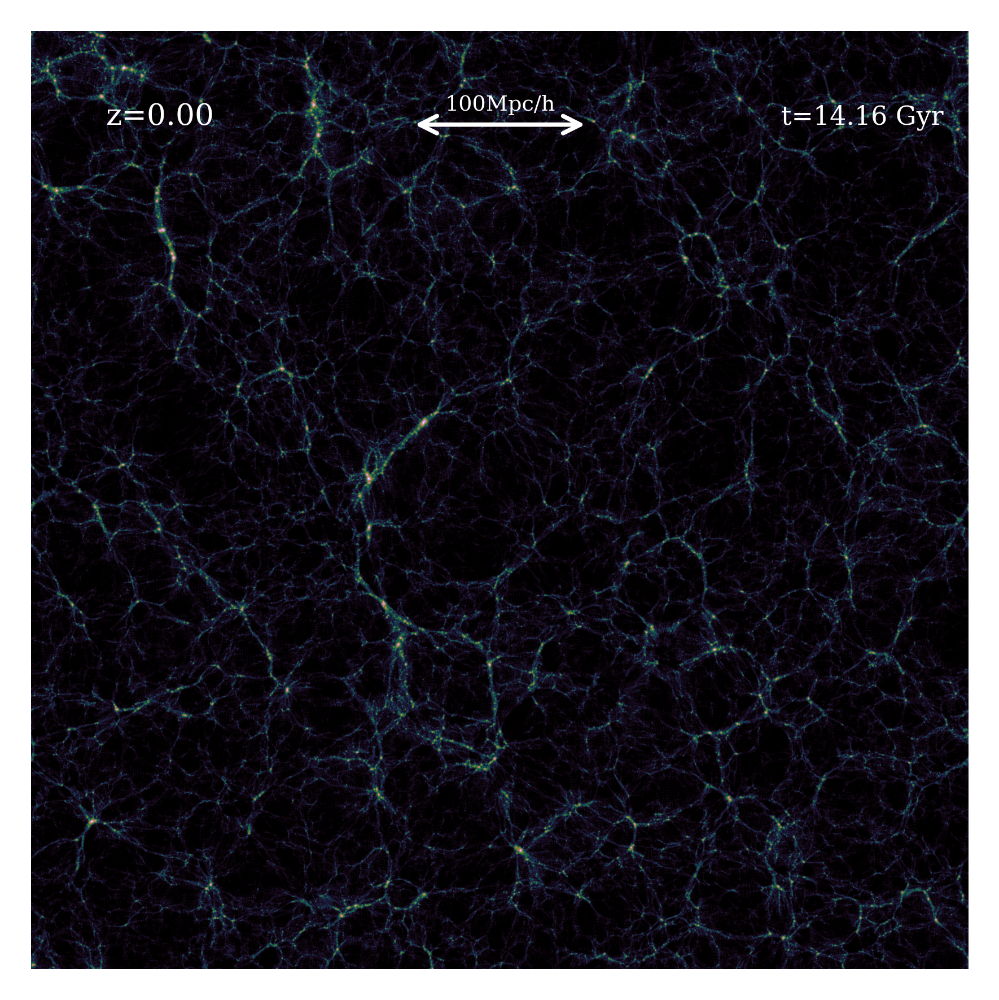

In [22]:
plt.imshow(zr, interpolation='bicubic', cmap=cmp, vmin=0.05, vmax=vmax, origin='lower')
plt.text(0.08*grid, 0.9*grid, 'z={:1.2f}'.format(z), color='white', size=7) 

plt.text(0.8*grid, 0.9*grid, 't={:1.2f} Gyr'.format(age), color='white', size=6)

plt.annotate("", xy=(0.4*grid, 0.9*grid), xytext=(0.6*grid, 0.9*grid), arrowprops=dict(arrowstyle='<->', linewidth=1, color='white'))
plt.text(0.5*grid, 0.915*grid, "100Mpc/h", ha='center', color='white', size=5)

plt.axis('off')


plt.savefig('./full_{}_bins{}_cmap{}_snap{}_vmax{}.png'.format(sim, grid, cmp, s, vmax), bbox_inches='tight', dpi=1000,  transparent=True)

In [ ]:
from astropy.cosmology import LambdaCDM
grid=2048
BoxSize=500
mlim = 1e14
vmax = 3.3
sim = 'm25s7'
cmp = 'cubehelix'
zmin, zmax = 100, 105
om0 = 0.25
s8 = 0.7 
h=0.7
cosmol = LambdaCDM(H0=100 * h, Om0=om0, Ode0=1 - om0)

for s in range(118):
    plt.figure()
    z, pos = bfi.read_pos(basefolder, sim, s)
    age = cosmol.age(z).value
    inds = np.where((pos[:,2]>=zmin) & (pos[:,2]<=zmax))[0]

    npos = pos[inds]
    npos[:,2]-= zmin
    ngroups=0
    
    density_field = np.zeros((grid,grid), dtype=np.float32)
    MASL.MA(npos[:,0:2].astype(np.float32), density_field, BoxSize, MAS='CIC')
    density_field /= np.mean(density_field)
    plt.imshow(np.log10(1+density_field.T), interpolation='sinc', cmap=cmp, vmin=0.05, vmax=vmax, origin='lower')
    if s>17:
        hal_x, hal_y, hal_z = bfi.read_hal_pos(basefolder, sim , s, mlim)
        nhal_x = hal_x[(hal_z>zmin)*(hal_z<zmax)]
        nhal_y = hal_y[(hal_z>zmin)*(hal_z<zmax)]
        ngroups = len(nhal_x)
        plt.scatter((nhal_x/BoxSize)*grid, (nhal_y/BoxSize)*grid, s=0.08, c='r')
    
    plt.text(0.08*grid, 0.9*grid, 'z={:1.2f}'.format(z), color='white', size=7) 
    plt.text(0.8*grid, 0.9*grid, 't={:1.2f} Gyr'.format(age), color='white', size=6)
    plt.text(0.08*grid, 0.85*grid, 'N={:1.0f}'.format(ngroups), color='white', size=7) 
    plt.text(0.05*grid, 0.15*grid, r'$\Omega_m$={:1.2f}'.format(om0), color='white', size=5)
    plt.text(0.05*grid, 0.1*grid, r'$\sigma_8$={:1.1f}'.format(s8), color='white', size=5)

    plt.annotate("", xy=(0.4*grid, 0.9*grid), xytext=(0.6*grid, 0.9*grid), arrowprops=dict(arrowstyle='<->', linewidth=1, color='white'))
    plt.text(0.5*grid, 0.915*grid, "100Mpc/h", ha='center', color='white', size=5)

    ax = plt.gca()
    ax.set_xticks([])
    ax.set_yticks([])

    plt.savefig('./snapfigs/full_{}_bins{}_cmap{}_snap{}_vmax{}_wgroups{:1.2e}.png'.format(sim, grid, cmp, s, vmax, mlim), bbox_inches='tight', dpi=1000, facecolor='white', transparent=False)


[]

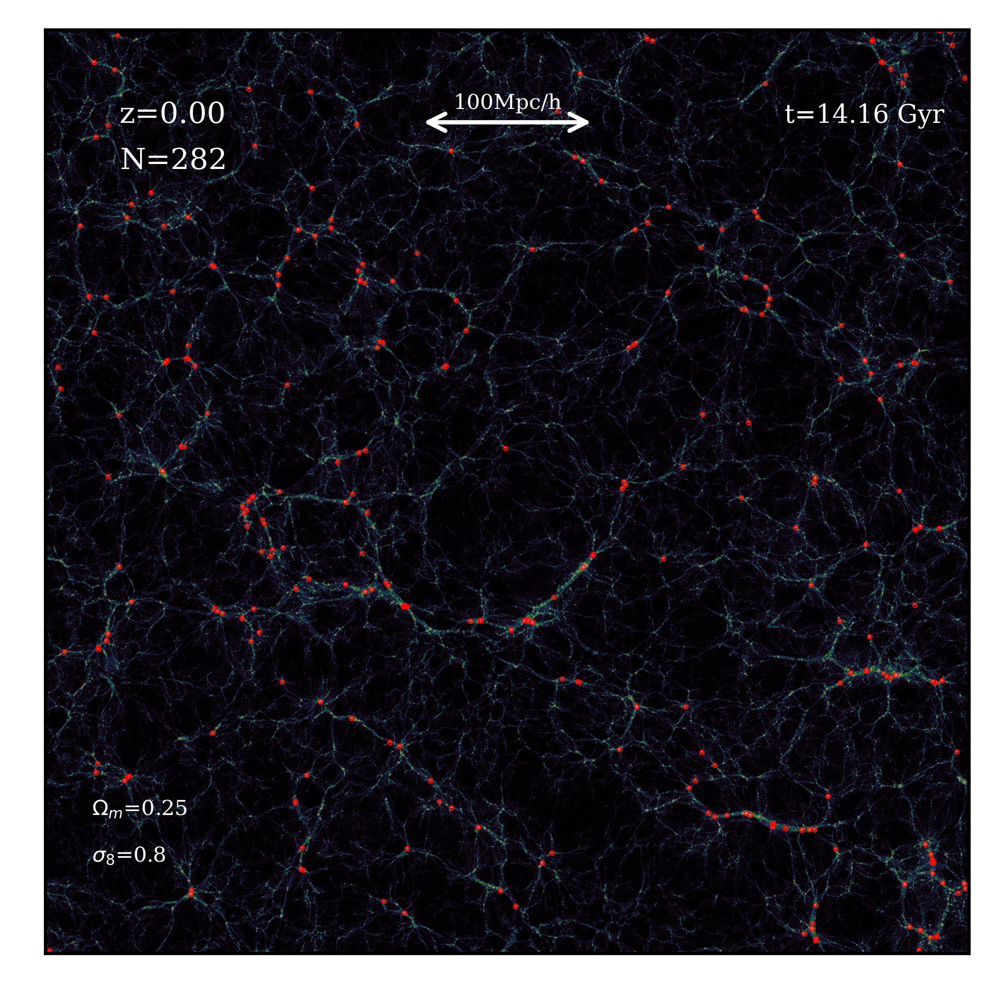

In [14]:
from astropy.cosmology import LambdaCDM

s= 118
grid=2048
BoxSize=500
mlim = 1e13
vmax = 3.3
sim = 'm25s7'
cmp = 'cubehelix'
zmin, zmax = 100, 105
om0 = 0.25
s8 = 0.8 
h=0.7
cosmol = LambdaCDM(H0=100 * h, Om0=om0, Ode0=1 - om0)


plt.figure()
z, pos = bfi.read_pos(basefolder, sim, s)
age = cosmol.age(z).value
inds = np.where((pos[:,2]>=zmin) & (pos[:,2]<=zmax))[0]

npos = pos[inds]
npos[:,2]-= zmin
ngroups=0

density_field = np.zeros((grid,grid), dtype=np.float32)
MASL.MA(npos[:,0:2].astype(np.float32), density_field, BoxSize, MAS='CIC')
density_field /= np.mean(density_field)
plt.imshow(np.log10(1+density_field.T), interpolation='sinc', cmap=cmp, vmin=0.05, vmax=vmax, origin='lower')
if s>17:
    hal_x, hal_y, hal_z = bfi.read_hal_pos(basefolder, sim , s, mlim)
    nhal_x = hal_x[(hal_z>zmin)*(hal_z<zmax)]
    nhal_y = hal_y[(hal_z>zmin)*(hal_z<zmax)]
    ngroups = len(nhal_x)
    plt.scatter((nhal_x/BoxSize)*grid, (nhal_y/BoxSize)*grid, s=0.08, c='r')

plt.text(0.08*grid, 0.9*grid, 'z={:1.2f}'.format(z), color='white', size=7) 
plt.text(0.8*grid, 0.9*grid, 't={:1.2f} Gyr'.format(age), color='white', size=6)
plt.text(0.08*grid, 0.85*grid, 'N={:1.0f}'.format(ngroups), color='white', size=7) 
plt.text(0.05*grid, 0.15*grid, r'$\Omega_m$={:1.2f}'.format(om0), color='white', size=5)
plt.text(0.05*grid, 0.1*grid, r'$\sigma_8$={:1.1f}'.format(s8), color='white', size=5)

plt.annotate("", xy=(0.4*grid, 0.9*grid), xytext=(0.6*grid, 0.9*grid), arrowprops=dict(arrowstyle='<->', linewidth=1, color='white'))
plt.text(0.5*grid, 0.915*grid, "100Mpc/h", ha='center', color='white', size=5)

ax = plt.gca()
ax.set_xticks([])
ax.set_yticks([])

#plt.savefig('./snapfigs/full_{}_bins{}_cmap{}_snap{}_vmax{}_wgroups{:1.2e}.png'.format(sim, grid, cmp, s, vmax, mlim), bbox_inches='tight', dpi=1000, facecolor='white', transparent=False)


In [10]:
from astropy.cosmology import LambdaCDM

s= 60
grid=2048
BoxSize=500
sim = 'm25s7'
cmp = 'cubehelix'
mlim = 1e13
zmin, zmax = 100, 105
om0 = 0.25
s8 = 0.8 
vmax = 3.3
cosmol = LambdaCDM(H0=100 * 0.7, Om0=om0, Ode0=1 - om0)
z, pos = bfi.read_pos(basefolder, sim, s)
age = cosmol.age(z).value
inds = np.where((pos[:,2]>=zmin) & (pos[:,2]<=zmax))[0]

npos = pos[inds]
npos[:,2]-= zmin
ngroups=0

density_field = np.zeros((grid,grid), dtype=np.float32)
MASL.MA(npos[:,0:2].astype(np.float32), density_field, BoxSize, MAS='CIC')
density_field /= np.mean(density_field)
hal_x, hal_y, hal_z = bfi.read_hal_pos(basefolder, sim , s, mlim)
nhal_x = hal_x[(hal_z>zmin)*(hal_z<zmax)]
nhal_y = hal_y[(hal_z>zmin)*(hal_z<zmax)]
ngroups = len(hal_x)


KeyboardInterrupt: 

[]

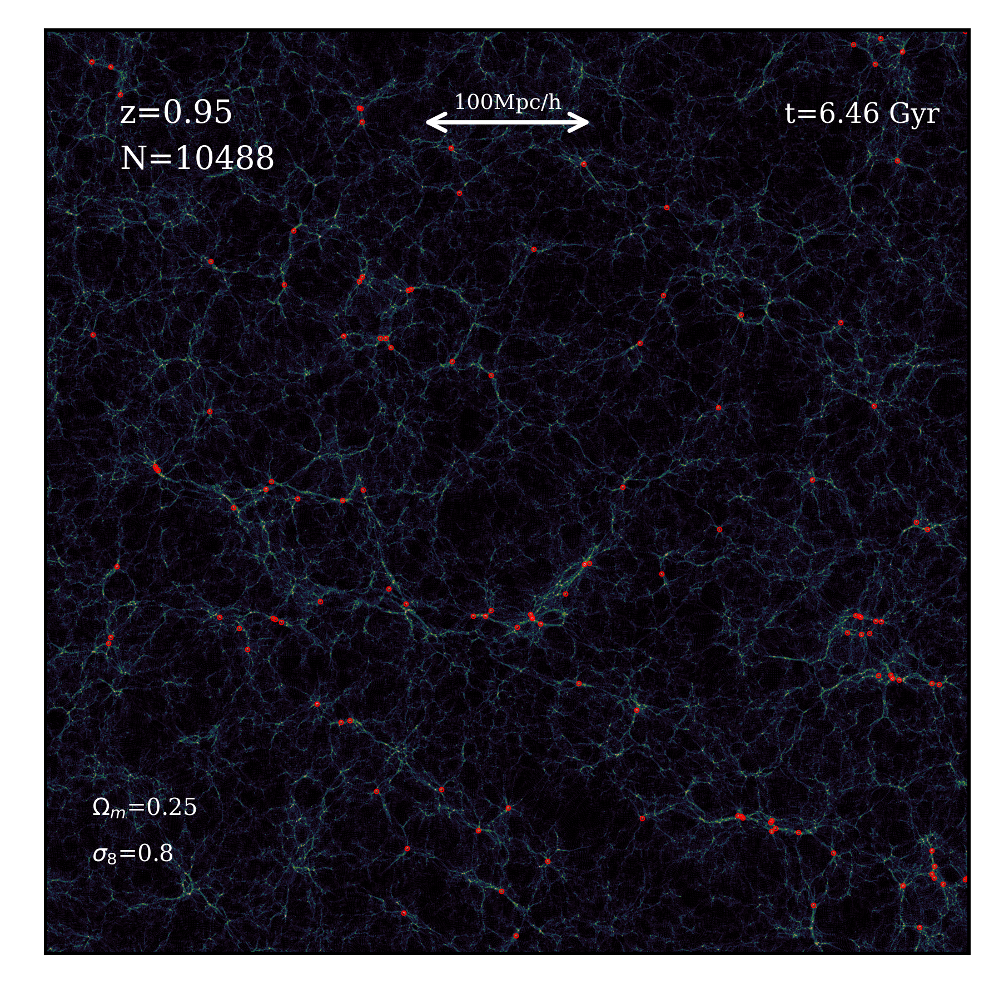

In [16]:
vmax = 3.3
plt.imshow(np.log10(1+density_field.T), interpolation='sinc', cmap=cmp, vmin=0.05, vmax=vmax, origin='lower')
plt.scatter((nhal_x/BoxSize)*grid, (nhal_y/BoxSize)*grid, s=0.08, c='r')



In [ ]:
grid = 2048
npos[:,2]-= zmin
density_field = np.zeros((grid,grid), dtype=np.float32)
MASL.MA(npos[:,0:2].astype(np.float32), density_field, BoxSize, MAS='CIC')
density_field /= np.mean(density_field)

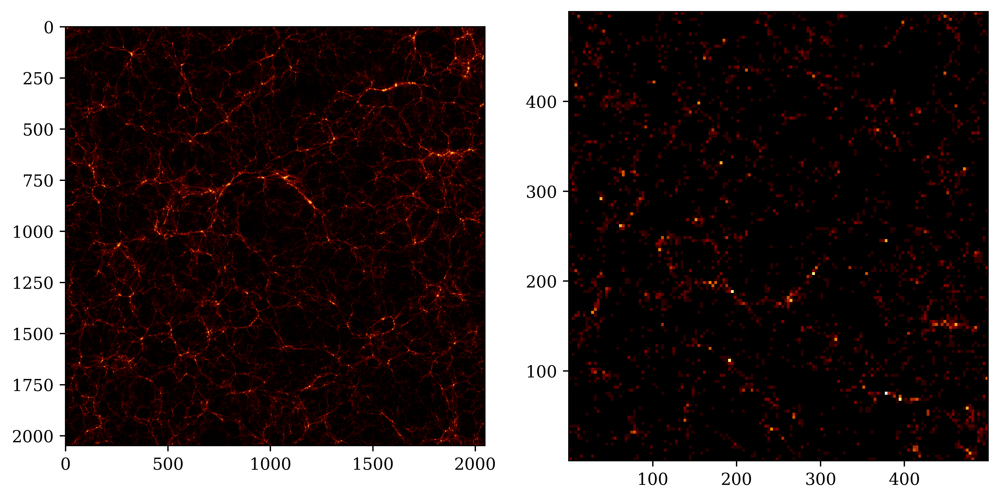

In [116]:
fig, axs = plt.subplots(1,2, figsize=[10,5])
axs[0].imshow(np.log10(1+density_field.T), interpolation='gaussian', cmap='afmhot', vmin=0.05, vmax=3.3, origin='lower')
h2= axs[1].hist2d(nhal_x, nhal_y, bins=150, cmap='afmhot')


In [48]:

#grid = 1024
zmin=0 
zmax=100 
#BoxSize=500
BoxSize=100
sim = 'm25s7'
sims = [['m25s7', 'm25s9'], ['m4s7', 'm4s9']]
omgs = [0.25, 0.4]
s8s = [0.7, 0.9]
cmaps = list(mpl.cm.cmap_d.keys())
cmpsel = ['afmhot', cmaps[46], cmaps[89]]
s = 20
#vmin, vmax = 0.05, 3.2
#hal_x, hal_y, hal_z = read_hal_pos(basefolder, sim , s)



z, pos = bfi.read_pos(basefolder, sim, s)
xmin, xmax = 0, 100
ymin, ymax = 0, 100
inds = np.where((pos[:,2]>=zmin)*(pos[:,2]<=zmax)*(pos[:,0]>=xmin)*(pos[:,0]<=xmax)*(pos[:,1]>=ymin)*(pos[:,1]<=ymax))[0]
#hinds = np.where((hal_z>=zmin)*(hal_z<=zmax)*(hal_x>=xmin)*(hal_x<=xmax)*(hal_y>=ymin)*(hal_y<=ymax))[0]
pos = pos[inds]
#hal_x, hal_y = hal_x[hinds], hal_y[hinds]
#pos[:,2] -= zmin
#x,y = pos[:,0], pos[:, 1]


/home/ayuba/scratch/m25s7/
8.589934592


In [61]:
hal_x, hal_y, hal_z = bfi.read_hal_pos(basefolder, sim , s)
zlim1, zlim2 =800, 1000
zhmin, zhmax = 100*0.5*zlim1/2048, 100*2*zlim2/2048
hinds = np.where((hal_z>=0)*(hal_z<=100)*(hal_x>=xmin)*(hal_x<=xmax)*(hal_y>=ymin)*(hal_y<=ymax))[0]
hal_x, hal_y = hal_x[hinds], hal_y[hinds]

In [50]:
grid = 2048

In [62]:
density_field = np.zeros((grid,grid, grid), dtype=np.float32)
MASL.MA(pos[:,0:3].astype(np.float32), density_field, BoxSize, MAS='CIC')

In [63]:
pden = np.sum(density_field[:,:, zlim1:zlim2], axis=2)/(zlim2-zlim1)


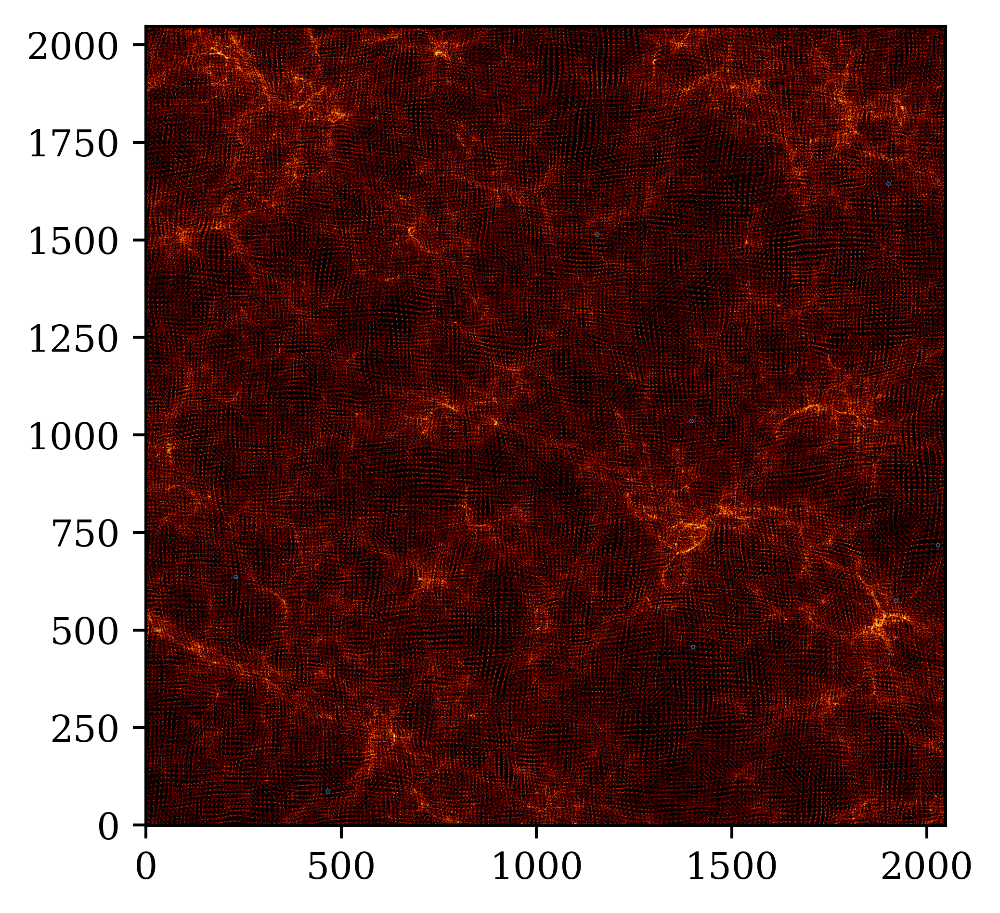

In [64]:
pden = pden/np.mean(pden)
plt.imshow(np.log10(1+pden), interpolation='gaussian', cmap=cmpsel[0], origin='lower')
plt.scatter(2048*(hal_x/100), 2048*(hal_y/100), s=0.05)

In [ ]:
z, pos = bfi.read_pos(basefolder, sim, 0)
bfi.plot_xyslice(pos, z, sim, grid=grid, zmin=zmin, zmax=zmax, vmin=0.05, vmax=3.22, BoxSize=BoxSize, cmap='afmhot', snap=s)

In [ ]:
z, pos = bfi.read_pos(basefolder, sim, 118)
bfi.plot_xyslice(pos, z, sim, grid=grid, zmin=zmin, zmax=zmax, vmin=0.05, vmax=3.22, BoxSize=BoxSize, cmap='afmhot', snap=118)

In [ ]:
grid=2048 
zmin=100 
zmax=105 
BoxSize=500
sim = 'm25s7'
cmaps = list(mpl.cm.cmap_d.keys())
cmpsel = ['afmhot', cmaps[46]]
for s in range(46,118):
    z, pos = bfi.read_pos(basefolder, sim, s)
    for cmp in cmpsel:
        if s%10 == 0:
            bfi.plot_xyslice(pos, z, sim, grid=grid, zmin=zmin, zmax=zmax, vmin=0.05, vmax='adapt', BoxSize=BoxSize, cmap=cmp, snap=s, show=True)
        else:
            bfi.plot_xyslice(pos, z, sim, grid=grid, zmin=zmin, zmax=zmax, vmin=0.05, vmax='adapt', BoxSize=BoxSize, cmap=cmp, snap=s, show=False)


# UNIVERSE SLICES 

/home/ayuba/scratch/m2s1/
8.589934592
0.0 3.9922686
/home/ayuba/scratch/m2s7/
8.589934592
0.0 3.771403
/home/ayuba/scratch/m3s8/
8.589934592
0.0 3.6678848
/home/ayuba/scratch/m4s7/
8.589934592
0.0 3.6447623
/home/ayuba/scratch/m4s9/
8.589934592
0.0 3.7582104


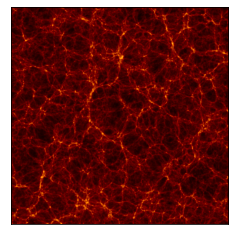

In [13]:
sims = ['m2s1', 'm2s7', 'm3s8', 'm4s7', 'm4s9']

for sim in sims:
    npos = bfi.read_pos(basefolder, sim, 118)
    bfi.plot_xyslice(npos, sim, grid=2024)
